# 1. Loading modules


In [1]:
%matplotlib inline
import time
import numpy as np
from time import sleep
from scipy import optimize
from scipy.interpolate import interp1d
from scipy.interpolate import *
from scipy.fftpack import fft
import matplotlib.pyplot as plt
from matplotlib import colormaps
list(colormaps)
import pandas as pd
from pprint import pprint
import os, sys

#from time import sleep, monotonic
from tqdm.notebook import tqdm
from scipy.signal import find_peaks
from scipy.signal import savgol_filter
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt

import qcodes as qc
from qcodes import Parameter
from qcodes import initialise_or_create_database_at
from qcodes import load_or_create_experiment
from qcodes.dataset.plotting import plot_dataset, plot_by_id
from qcodes.utils.metadata import diff_param_values
from qcodes.instrument.specialized_parameters import ElapsedTimeParameter

import pyppt as ppt

In [2]:
dirpath = os.getcwd()
# sample_name = dirpath.split('\\')[-2]
# wafer_name = dirpath.split('\\')[-3]
db_path = dirpath.rsplit('\\',0)[0]

In [3]:
files = []
# r=root, d=directories, f = files
for r, d, f in os.walk(db_path):
    for file in f:
        if '.db' in file:
            files.append(os.path.join(r, file))

for f in files:
    print(f)

d:\data\Albert\103\103_2024-05-11_01.db
d:\data\Albert\103\103_2024-05-11_01.db-shm
d:\data\Albert\103\103_2024-05-11_01.db-wal


In [2]:
# db_path = os.path.join(db_path,'103_2024-05-11_01.db')
initialise_or_create_database_at(r'104Data\104_2024-05-26_01.db')


# 2. Experiments List


In [3]:
qc.experiments()

[IV#103-1KΩ#1@c:\Users\quant\SynologyDrive\00 Users\Albert\10_Data\03_Data analysis\104Data\104_2024-05-26_01.db
 ---------------------------------------------------------------------------------------------------------------
 1-results-1-appl_current,meas_voltage_K2-101,
 IV#103-1KΩ#2@c:\Users\quant\SynologyDrive\00 Users\Albert\10_Data\03_Data analysis\104Data\104_2024-05-26_01.db
 ---------------------------------------------------------------------------------------------------------------
 2-results-1-appl_current,meas_voltage_K2-101,
 IV#103-1KΩ#3@c:\Users\quant\SynologyDrive\00 Users\Albert\10_Data\03_Data analysis\104Data\104_2024-05-26_01.db
 ---------------------------------------------------------------------------------------------------------------
 3-results-1-appl_current,meas_voltage_K2-101,
 IV#104-1KΩ#4@c:\Users\quant\SynologyDrive\00 Users\Albert\10_Data\03_Data analysis\104Data\104_2024-05-26_01.db
 -------------------------------------------------------------------

Trying to mark a run completed that was already completed.


([<Axes: title={'center': 'Run #280, Experiment IV-By (104-03_J2_23-22-20-21G_1MΩ_+By_Wait1e-05)'}, xlabel='field (mT)', ylabel='appl_current (μA)'>],
 [<matplotlib.colorbar.Colorbar at 0x19d095b32d0>])

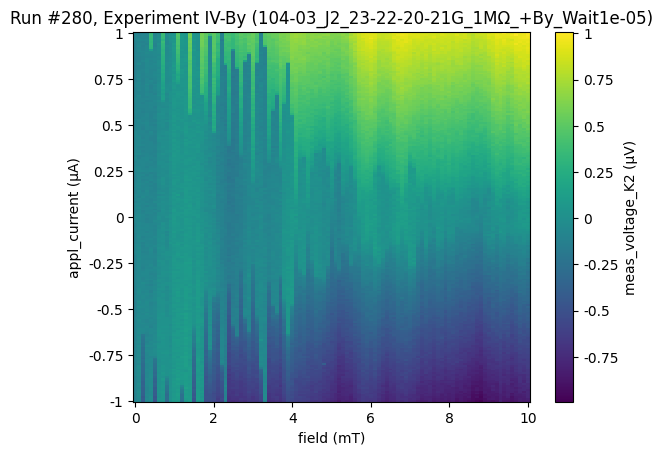

In [11]:
plot_by_id(280)

In [12]:
from qcodes.dataset import load_by_run_spec

In [17]:
dataset = load_by_run_spec(captured_run_id=280)

In [18]:
field_data = dataset.get_data("3d_magnet_field_measured")
theta_data = dataset.get_data("3d_magnet_theta_measured")
phi_data = dataset.get_data("3d_magnet_phi_measured")

AttributeError: 'DataSet' object has no attribute 'get_data'

In [19]:
print(dataset.paramspecs.keys())

dict_keys(['y_field', 'appl_current', 'meas_voltage_K2'])


In [6]:
id=1
dataset = qc.load_by_id(id)

def get_R_from_IV(id=id):
    dataset = qc.load_by_id(id)

    voltage = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2'] #['meas_voltage_K1']['meas_voltage_K1']
    current = dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] #['meas_voltage_K1']['appl_current']
    fit_values = np.polyfit(current,voltage,1)
    
    return fit_values[0]

def IV(dataset=dataset,id=id):
    import plotly.graph_objs as go
    dataset = qc.load_by_id(id)
    R = get_R_from_IV(id)
    pandas_dataframe = dataset.to_pandas_dataframe()
    # Assuming 'pandas_dataframe' is your pandas DataFrame
    # Extract x and y data from the DataFrame
    x_data = pandas_dataframe.index.tolist()
    y_data = pandas_dataframe['meas_voltage_K2'].tolist()

    # Create a Plotly trace
    trace = go.Scatter(x=x_data, y=y_data, mode='lines', name='Voltage vs. Current')

    # Create layout
    layout = go.Layout(title=f'Run #{id} I vs. V,  R_fit={R:.4f} Ω',
                    xaxis=dict(title='Current'),
                    yaxis=dict(title='Voltage'),
                    width=600, height=600
                    )

    # Create the figure
    fig = go.Figure(data=[trace], layout=layout)

    # Plot the figure
    fig.show()

def IV_diff(dataset=dataset,id=id):
    import numpy as np
    import plotly.graph_objs as go
    from scipy.signal import find_peaks
    dataset = qc.load_by_id(id)
    # Convert the dataset to a pandas dataframe
    pandas_dataframe = dataset.to_pandas_dataframe()

    # Assuming 'pandas_dataframe' is your pandas DataFrame
    # Extract current and voltage data from the DataFrame
    current = pandas_dataframe.index.tolist()
    voltage = pandas_dataframe['meas_voltage_K2'].tolist()

    # Compute differential of voltage with respect to current
    differential_voltage = np.diff(voltage) / np.diff(current)

    # Since the differential will have one less data point, adjust the current data
    # to have the same length as the differential data
    current = current[:-1]

    # Find peaks in the differential signal
    peaks, _ = find_peaks(differential_voltage)

    # Extract peak current and peak differential voltage values
    peak_current = [current[i] for i in peaks]
    peak_voltage_diff = [differential_voltage[i] for i in peaks]

    # Sort the peaks based on their values
    sorted_peak_indices = np.argsort(peak_voltage_diff)[::-1]  # Sort in descending order
    top_two_peak_indices = sorted_peak_indices[:2]  # Select the top two indices

    # Extract the top two peaks
    top_two_peak_current = [peak_current[i] for i in top_two_peak_indices]
    top_two_peak_voltage_diff = [peak_voltage_diff[i] for i in top_two_peak_indices]

    # Calculate the center points of the top two peaks
    center_points = [(top_two_peak_current[i] + top_two_peak_current[i+1]) / 2 for i in range(len(top_two_peak_current) - 1)]

    # Calculate the difference between the top two biggest peaks
    peak_difference = abs(top_two_peak_current[0] - top_two_peak_current[1])

    # Determine the appropriate unit for current
    if peak_difference >= 1e-3:
        unit = "mA"
        conversion_factor = 1e3
    elif peak_difference >= 1e-6:
        unit = "μA"
        conversion_factor = 1e6
    else:
        unit = "nA"
        conversion_factor = 1e9

    # Determine the appropriate unit for current
    if peak_difference >= 1e-3:
        unit = "mA"
    elif peak_difference >= 1e-6:
        unit = "μA"
    elif peak_difference >= 1e-9:
        unit = "nA"
    else:
        unit = "pA"

    # Create a Plotly trace for the differential
    trace_diff = go.Scatter(x=[c * conversion_factor for c in current], y=differential_voltage, mode='lines', name='d(Voltage)/d(Current)')
    # Add markers for the top two peaks
    trace_top_two_peaks = go.Scatter(x=[p * conversion_factor for p in top_two_peak_current], y=top_two_peak_voltage_diff, mode='markers', marker=dict(color='red'), name='Top Two Peaks')
    # Add markers for the center points
    trace_center_points = go.Scatter(x=center_points, y=[0]*len(center_points), mode='markers', marker=dict(color='blue', symbol='cross'), name='Center Points')

    # Create layout
    layout = go.Layout(title=f'Run #{id} I vs. dV/dI',
                    xaxis=dict(title=f'Current ({unit})'),
                    yaxis=dict(title='d(Voltage)/d(Current)'),
                    legend=dict(orientation="h", yanchor="top", y=1.10, xanchor="center", x=0.5),
                    width=600, height=600  
                    )

    # Create the figure
    fig = go.Figure(data=[trace_diff, trace_top_two_peaks, trace_center_points], layout=layout)

    # Add annotation for the current value of center points
    for i, center_point in enumerate(center_points):
        fig.add_annotation(
            x=center_point * conversion_factor,
            y=0, #0.4 * max(differential_voltage),
            text=f'Center Point: {center_point * conversion_factor:.3f}{unit} <br> Peak difference: {peak_difference*conversion_factor:.3f} {unit}',
            showarrow=True,
            arrowhead=2,
            arrowsize=1,
            arrowwidth=2,
            arrowcolor='black',
            ax=-100,
            ay=-200 - 30 * i
        )

    # Plot the figure
    fig.show()

# Analysis


## 1D


In [7]:
id=58
print(id)

58


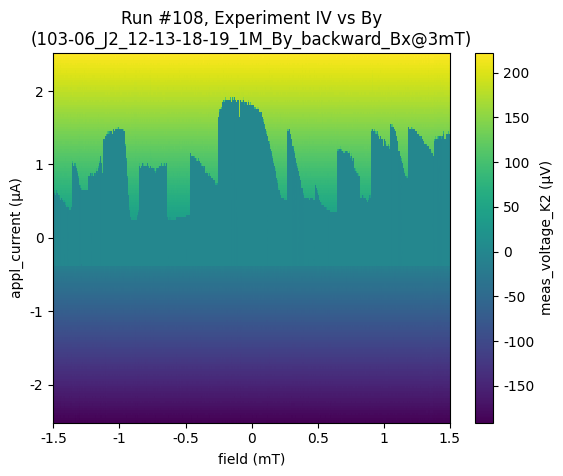

In [49]:
axs, cbs = plot_dataset(dataset)

In [50]:
axs

[<AxesSubplot:title={'center':'Run #108, Experiment IV vs By\n(103-06_J2_12-13-18-19_1M_By_backward_Bx@3mT)'}, xlabel='field (mT)', ylabel='appl_current (μA)'>]

In [51]:
cbs

In [65]:
dataset.keys()

AttributeError: 'DataSet' object has no attribute 'keys'

In [66]:
pprint(dataset)

results #108@d:\data\Albert\103\103_2024-05-11_01.db
----------------------------------------------------
y_field - numeric
appl_current - numeric
meas_voltage_K2 - numeric


In [69]:
meas_voltage_K2_data= dataset["meas_voltage_K2"]

TypeError: 'DataSet' object is not subscriptable

In [48]:
type(dataset)

qcodes.dataset.data_set.DataSet

In [59]:
data_dict = dataset.to_pandas_dataframe_dict()
print(data_dict.keys())  # This will print all the available keys in the dictionary


dict_keys(['meas_voltage_K2'])


In [60]:
meas_voltage_K2_data = pd.DataFrame(dataset.to_pandas_dataframe_dict()["meas_voltage_K2"])

# You can't access "y_field" or "appl_current" as they're not present in the dataset


In [61]:
meas_voltage_K2_data

meas_voltage_K2
y_field appl_current                 
 0.0015 -0.000003           -0.000189
        -0.000002           -0.000186
        -0.000002           -0.000184
        -0.000002           -0.000181
        -0.000002           -0.000178
...                               ...
-0.0015  0.000002            0.000210
         0.000002            0.000213
         0.000002            0.000215
         0.000002            0.000218
         0.000003            0.000220

[151151 rows x 1 columns]

In [64]:
import pandas as pd
import numpy as np

# Assuming data for these columns is missing
y_field_data = np.nan * np.ones(len(meas_voltage_K2_data))
appl_current_data = np.nan * np.ones(len(meas_voltage_K2_data))

# Create a new DataFrame with desired column names and placeholders
new_df = pd.DataFrame({
    "y_field": y_field_data,
    "appl_current": appl_current_data,
    "meas_voltage_K2": meas_voltage_K2_data["meas_voltage_K2"]
})

print(new_df)


                      y_field  appl_current  meas_voltage_K2
y_field appl_current                                        
 0.0015 -0.000003         NaN           NaN        -0.000189
        -0.000002         NaN           NaN        -0.000186
        -0.000002         NaN           NaN        -0.000184
        -0.000002         NaN           NaN        -0.000181
        -0.000002         NaN           NaN        -0.000178
...                       ...           ...              ...
-0.0015  0.000002         NaN           NaN         0.000210
         0.000002         NaN           NaN         0.000213
         0.000002         NaN           NaN         0.000215
         0.000002         NaN           NaN         0.000218
         0.000003         NaN           NaN         0.000220

[151151 rows x 3 columns]


In [63]:
import pandas as pd

# Assuming data for these columns is missing
y_field_data = pd.Series([np.nan] * len(meas_voltage_K2_data))
appl_current_data = pd.Series([np.nan] * len(meas_voltage_K2_data))

# Create a new DataFrame with desired column names and placeholders
new_df = pd.DataFrame({
    "y_field": y_field_data,
    "appl_current": appl_current_data,
    "meas_voltage_K2": meas_voltage_K2_data["meas_voltage_K2"]
})

print(new_df)


C:\Users\admin\AppData\Local\Temp\ipykernel_12948\2103480413.py:8: RuntimeWarning:

'<' not supported between instances of 'tuple' and 'int', sort order is undefined for incomparable objects.



                                 y_field  appl_current  meas_voltage_K2
0                                    NaN           NaN              NaN
1                                    NaN           NaN              NaN
2                                    NaN           NaN              NaN
3                                    NaN           NaN              NaN
4                                    NaN           NaN              NaN
...                                  ...           ...              ...
(-0.0015, 2.36666666666667e-06)      NaN           NaN         0.000210
(-0.0015, 2.4e-06)                   NaN           NaN         0.000213
(-0.0015, 2.43333333333333e-06)      NaN           NaN         0.000215
(-0.0015, 2.46666666666667e-06)      NaN           NaN         0.000218
(-0.0015, 2.5e-06)                   NaN           NaN         0.000220

[302302 rows x 3 columns]


In [47]:
y_field_data = dataset["data"]["y_field"]  # Assuming data is nested within a "data" key


TypeError: 'DataSet' object is not subscriptable

In [46]:
y_field_data = dataset["y_field"]  # Assuming "y_field" is a key in the dictionary


TypeError: 'DataSet' object is not subscriptable

In [44]:
dataset["y_field"]

TypeError: 'DataSet' object is not subscriptable

In [9]:
df.to_csv("#108")

In [10]:
# Specify the path to your.csv file
csv_file_path = r'D:\data\Albert\103\#108'

# Use the read_csv() function to convert the.csv file to a DataFrame
df = pd.read_csv(csv_file_path)

In [11]:
df

,y_field,appl_current,meas_voltage_K2
0,0.0015,-0.000003,-0.000189
1,0.0015,-0.000002,-0.000186
2,0.0015,-0.000002,-0.000184
3,0.0015,-0.000002,-0.000181
4,0.0015,-0.000002,-0.000178
...,...,...,...
151146,-0.0015,0.000002,0.000210
151147,-0.0015,0.000002,0.000213
151148,-0.0015,0.000002,0.000215
151149,-0.0015,0.000002,0.000218


In [42]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Heatmap(
                    x=df['y_field'],
                    y=df['appl_current'],
                    z=df['meas_voltage_K2'],
                    colorbar={"title": "meas_voltage_K2"},
                    colorscale='RdBu'), 
                layout=dict(
                    xaxis_title="y_field",
                    yaxis_title="appl_current",
                    
                    ))
fig.show()

In [14]:
# Assuming df already contains x_field and appl_current columns

df['differential_voltage'] = (df['meas_voltage_K2'].shift(-1) - df['meas_voltage_K2'].shift(1)) / (2 * (df['appl_current'].shift(-1) - df['appl_current']))


In [16]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Heatmap(
                    x=df['y_field'],
                    y=df['appl_current'],
                    z=df['differential_voltage'],
                    colorscale='RdBu'))

fig.show()

Trying to mark a run completed that was already completed.


R_fit = 70.1491337845152 Ω


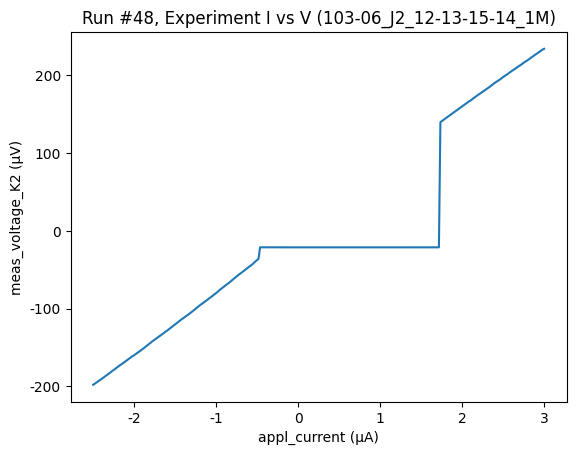

In [74]:
#only one curve
dataid=48
dataset = qc.load_by_id(dataid)
# plot_dataset(dataset, fig_index=2)  # Use fig_index=2 to display Figure 3
plot_dataset(dataset)
print(f"R_fit = {get_R_from_IV(dataid)} Ω")
IV(id=dataid)
IV_diff(id=dataid)

In [76]:
import pandas as pd

data = """103-01 R@RT(Ω) 1245.72 103-01 R@LT(Ω) 155 103-01 Ic_max(μA) 0.58 103-01 Ic_Rn 89.9 103-02 R@RT(Ω) 1290.3 1322.54 1649.22 103-02 R@LT(Ω) 482.66 2724.69 3254 103-02 Ic_max(μA) 103-03 R@RT(Ω) 1742.28 1346.39 2296.17 103-03 R@LT(Ω) 266.3 236.94 2876.11 103-03 Ic_max(μA) 0.66 1.893 103-03 Ic_Rn 175.758 448.527 103-04 R@RT(Ω) 1924.52 800 103-04 R@LT(Ω) 2748.51 80.74 103-04 Ic_max(μA) 0.86 103-04 Ic_Rn 69.4364 103-06 R@RT(Ω) 2076.96 804.16 103-06 R@LT(Ω) 72.41 70.64 103-06 Ic_max(μA) 1.747 2.2 103-06 Ic_Rn 126.5 155.408 103-07 R@RT(Ω) 3341.87 103-07 R@LT(Ω) 4076.59 103-07 Ic_max(μA)"""

data_cleaned = [row.split() for row in data.split("\n")]
df = pd.DataFrame(data_cleaned, columns=['Code', 'Parameter', 'Value1', 'Value2', 'Value3'])

ValueError: 5 columns passed, passed data had 80 columns

In [80]:
from tqdm import tqdm
import time

# First loop
for i in tqdm(range(6), desc="First loop"):
    magnet_y.field((3 + i) * 1e-3)
    time.sleep(10)

# Pause for 30 seconds
time.sleep(30)

# Second loop
for i in tqdm(range(6), desc="Second loop"):
    magnet_y.field((8 - i) * 1e-3)
    time.sleep(10)

# Pause for 180 seconds
time.sleep(300)

In [ ]:
for set_point1 in tqdm(np.linspace(start1, stop1, num_points1), desc='first parameter'):
            param_set1.set(set_point1)
            for set_point2 in  tqdm(np.linspace(start2, stop2, num_points2), desc='nested  parameter', leave=False):
                param_set2.set(set_point2)
                for i, parameter in enumerate(param_meas):
                    output[i][1] = parameter.get()
                datasaver.add_result((param_set1, set_point1),
                                     (param_set2, set_point2),
                                     *output)
            param_set2.set(start2)

In [12]:
runid=17
print(get_R_from_IV(runid))

1038.895178831683


In [13]:
##### Keithley1 = dataset.get_parameter_data()['meas_voltage_K1']['meas_voltage_K1']
Keithley2 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# lockin_1_X = dataset.get_parameter_data()['meas_voltage_ac_L1']['meas_voltage_ac_L1']
# lockin_2_X = dataset.get_parameter_data()['meas_voltage_ac_L2']['meas_voltage_ac_L2']
# crymag_field = dataset.get_parameter_data()['meas_voltage_K1']['magnet_x_ramp'] ##correction in perpendiculr direction
# By_field =dataset.get_parameter_data()['meas_voltage_K1']['y_field'] ##correction in perpendiculr direction
#Bx_field =dataset.get_parameter_data()['meas_voltage_K2']['x_field'] ##correction in perpendiculr direction
# Power_dependence = dataset.get_parameter_data()['meas_current_K2']['SGS_power']
#Power_dependence =dataset.get_
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
#Vg= dataset.get_parameter_data()['meas_current_K2']['appl_TG']
# Iac = dataset.snapshot['station']['parameters']['appl_current_AC_L1']['raw_value']

##### IV diff


In [14]:
import numpy as np

# 假设dataid是一个包含您量测数据的数组
dataset = qc.load_by_id(11)
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
Keithley2 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']

# 计算电压值的微分
V_diff = np.diff(Keithley2)/ np.diff(I) 

# 如果您想保持数据的长度与微分前一致，可以在最后添加一个NaN值
Vdiff = np.append(V_diff, np.nan)

plt.plot(Vdiff)
# 现在，voltage_diff 就是电压的微分数据
plt.show()

In [16]:
runid=17
print(get_R_from_IV(runid))

1038.895178831683


## diff


### PD


([<Axes: title={'center': 'Run #6517, Experiment IV-RF_p\n(103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_RF@12.3115GHz_By@0.1mT)'}, xlabel='Power (dBm)', ylabel='appl_current (μA)'>],
 [<matplotlib.colorbar.Colorbar at 0x1fed6502210>])

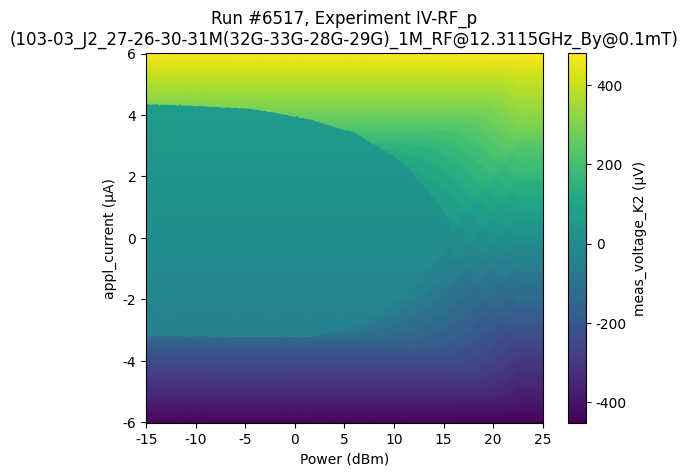

In [9]:
#only one curve
dataset = qc.load_by_id(6517)

# plot_dataset(dataset, fig_index=2)  # Use fig_index=2 to display Figure 3
plot_dataset(dataset)

In [10]:
# Keithley1 = dataset.get_parameter_data()['meas_voltage_K1']['meas_voltage_K1']
Keithley2 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# lockin_1_X = dataset.get_parameter_data()['meas_voltage_ac_L1']['meas_voltage_ac_L1']
# lockin_2_X = dataset.get_parameter_data()['meas_voltage_ac_L2']['meas_voltage_ac_L2']
# crymag_field = dataset.get_parameter_data()['meas_voltage_K1']['magnet_x_ramp'] ##correction in perpendiculr direction
# By_field =dataset.get_parameter_data()['meas_voltage_K1']['y_field'] ##correction in perpendiculr direction
#Bx_field =dataset.get_parameter_data()['meas_voltage_K2']['x_field'] ##correction in perpendiculr direction
Power_dependence = dataset.get_parameter_data()['meas_voltage_K2']['SGS_power']
#Power_dependence =dataset.get_
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
# Iac = dataset.snapshot['station']['parameters']['appl_current_AC_L1']['raw_value']

In [11]:
# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if By_field[i]!=By_field[i+1]:
    if Power_dependence[i]!=Power_dependence[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N
# NVg=s//N
print('size of the field array', NB)
# print('size of the gate array', NVg)
print('size of the current', NI)

size of the field array 801
size of the current 401


In [12]:
#DC Bias vs. field 
R_DC1 = Keithley2/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
# R_DC1 = R_DC1.reshape(NVg,NI)
R_DC1_d = np.diff(R_DC1, axis = 1)
# R_DC2 = Keithley2/(I[2]-I[1])A
# R_DC1_d = R_DC1_d.reshape(NB,NI)
# R_DC2 = R_DC2.reshape(NVg,NI)
# R_DC2 = np.diff(R_DC2, axis = 1)
# R_DC1=R_DC1.transpose()
I=I.reshape(NB,NI)
# I=I.reshape(NVg,NI)
# I=I.transpose()
# By_field =By_field.reshape(NB,NI)
#Bx_field =Bx_field.reshape(NB,NI)
Power_dependence =Power_dependence.reshape(NB,NI)
Keithley2 = Keithley2.reshape(NB,NI)
# Vg = Vg.reshape(NVg,NI)
# crymag_field=crymag_field.transpose()

#### 對 I 作圖


In [17]:
import matplotlib.pyplot as plt

C:\Users\admin\AppData\Local\Temp\ipykernel_23236\134953022.py:8: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  im = ax0.pcolormesh(Power_dependence[Arange:Brange,0:NI-1], Keithley2[Arange:Brange,0:NI-1]/1e-6, R_DC1_d[Arange:Brange,0:NI-1], cmap = cmap, vmax=80,vmin=0)


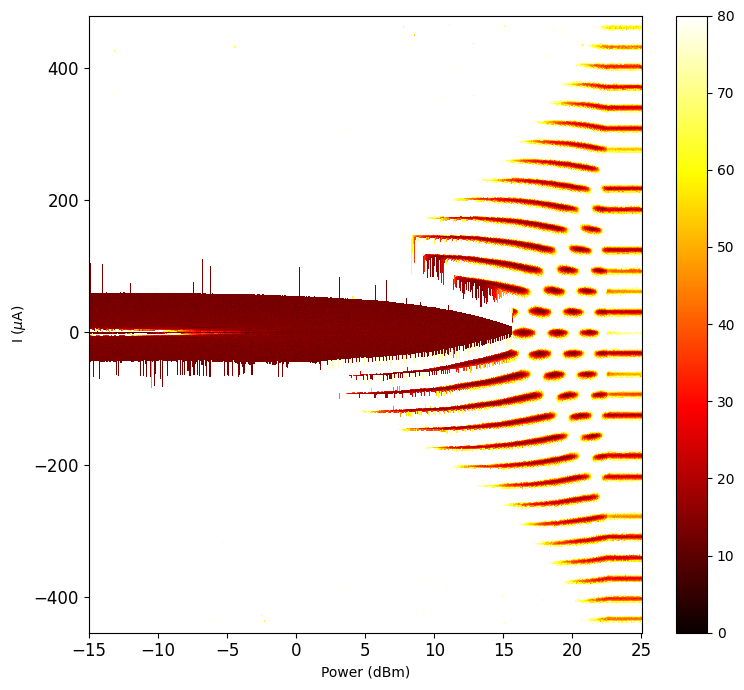

In [21]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8,7))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=0
Brange=8000

im = ax0.pcolormesh(Power_dependence[Arange:Brange,0:NI-1], Keithley2[Arange:Brange,0:NI-1]/1e-6, R_DC1_d[Arange:Brange,0:NI-1], cmap = cmap, vmax=80,vmin=0)
fig.colorbar(im, ax=ax0)

ax0.set(xlabel='Power (dBm)', ylabel='I ($\mu$A)') 
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

fig.tight_layout()
#plt.grid()
plt.show()
# ppt.add_figure('Center')

In [23]:
import matplotlib.pyplot as plt
import numpy as np

# Example data (replace these with your actual data)
Power_dependence =Power_dependence.reshape(NB,NI)
Keithley2 = Keithley2.reshape(NB,NI)
R_DC1 = Keithley2/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
# R_DC1 = R_DC1.reshape(NVg,NI)
R_DC1_d = np.diff(R_DC1, axis = 1)

# Define the edges
x_edges = np.linspace(Power_dependence.min(), Power_dependence.max(), Power_dependence.shape[1] + 1)
y_edges = np.linspace(Keithley2.min(), Keithley2.max(), Keithley2.shape[0] + 1)

fig, ax0 = plt.subplots(ncols=1, figsize=(8, 7))
cmap = plt.get_cmap('hot')

# Use explicit cell edges
im = ax0.pcolormesh(x_edges, y_edges/1e-6, R_DC1_d, cmap=cmap, vmax=80, vmin=0)
plt.show()


ValueError: cannot reshape array of size 10000 into shape (801,401)

#### 對 V 作圖


In [ ]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8,7))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=0
Brange=800
im = ax0.pcolormesh(Power_dependence[Arange:Brange,0:NI-1], Keithley2[Arange:Brange,0:NI-1]/1e-6, R_DC1_d[Arange:Brange,0:NI-1], cmap = cmap, vmax=80,vmin=0)
fig.colorbar(im, ax=ax0)
# ax0.set_title('id=run140')
ax0.set(xlabel='Power (dBm)', ylabel='V ($\mu$V)') 


fig.tight_layout()
#plt.grid()
plt.show()
# ppt.add_figure('Center')

#### 2D to 1D


In [ ]:
runid=132
dataset = qc.load_by_id(runid)

In [ ]:
# Keithley1 = dataset.get_parameter_data()['meas_voltage_K1']['meas_voltage_K1']
V_3 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# lockin_1_X = dataset.get_parameter_data()['meas_voltage_ac_L1']['meas_voltage_ac_L1']
# lockin_2_X = dataset.get_parameter_data()['meas_voltage_ac_L2']['meas_voltage_ac_L2']
# crymag_field = dataset.get_parameter_data()['meas_voltage_K1']['magnet_x_ramp'] ##correction in perpendiculr direction
#By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field'] ##correction in perpendiculr direction
#Bx_field =dataset.get_parameter_data()['meas_voltage_K2']['x_field'] ##correction in perpendiculr direction
PD_3 = dataset.get_parameter_data()['meas_voltage_K2']['SGS_power']
#Power_dependence =dataset.get_
I_3 = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
# Iac = dataset.snapshot['station']['parameters']['appl_current_AC_L1']['raw_value']

In [ ]:
# s=len(Vg)
s=len(I_3)
#print(s)
N=1
for i in range(s):
   # if Bx_field[i]!=Bx_field[i+1]:
     if PD_3[i]!=PD_3[i+1]:
#    if Vg[i]!=V[i+1]:
        break 
     else:
        N=N+1
        print('size of the field array',N, end='\r')

NI_3=N
NB_3=s//N


#NVg=s//N
print('size of the field array', NB_3)
#print('size of the gate array', NVg)
print('size of the current', NI_3)

In [ ]:
# #DC Bias vs. field 
R_DC1 = V_3/(I_3[2]-I_3[1])
R_DC1 = R_DC1.reshape(NB_3,NI_3)
# R_DC1 = R_DC1.reshape(NVg,NI)
R_DC1_d = np.diff(R_DC1, axis = 1)
# R_DC2 = Keithley2/(I[2]-I[1])A
# R_DC1_d = R_DC1_d.reshape(NB,NI)
# R_DC2 = R_DC2.reshape(NVg,NI)
# R_DC2 = np.diff(R_DC2, axis = 1)
# R_DC1=R_DC1.transpose()
# I=I.reshape(NB,NI)
I_3=I_3.reshape(NB_3,NI_3)
# I=I.transpose()
#By_field =By_field.reshape(NB,NI)
#Bx_field =Bx_field.reshape(NB,NI)
PD_3=PD_3.reshape(NB_3,NI_3)
V_3= V_3.reshape(NB_3,NI_3)
#Vg = Vg.reshape(NVg,NI)
# crymag_field=crymag_field.transpose()

In [ ]:
R_DC1[1,:]

In [ ]:
R_fit=np.empty((NB_3))
for i in range(NB_3):
    R = np.polyfit(I_3[i,:], V_3[i,:],1)
    R_fit[i]=R[0]

In [ ]:
plt.figure(figsize=(5, 3))
# plt.subplot(131)
#plt.plot(I[N-1,:]/1e-6, Keithley2[N-1,:]/1e-3)
# plt.plot(Bx_field[:,10], R_DC1[:,10] , label='BxV')
for i in range(20):
    i=i+45

    plt.plot(I_3[i,:]/1e-6, 1.5*V_3[i,:]/1e-5 , label='BxR')

plt.title('# 3.387GHz ')
plt.xlabel('I ($\mu$A)')
plt.ylabel('V ($\\frac{\hbar\\omega}{2e}$)')
plt.grid(True)



plt.show()

In [ ]:
plt.plot(I_3[i,:]/1e-6, 1.5*V_3[i,:]/1e-5 , label='BxR')
plt.plot(I_6[i,:]/1e-6, 1.5*V_6[i,:]/1e-5 , label='BxR')

### Bx


In [ ]:
#only one curve
dataset = qc.load_by_id(47)

# plot_dataset(dataset, fig_index=2)  # Use fig_index=2 to display Figure 3
plot_dataset(dataset)

In [ ]:
# Keithley1 = dataset.get_parameter_data()['meas_voltage_K1']['meas_voltage_K1']
Keithley2 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# lockin_1_X = dataset.get_parameter_data()['meas_voltage_ac_L1']['meas_voltage_ac_L1']
# lockin_2_X = dataset.get_parameter_data()['meas_voltage_ac_L2']['meas_voltage_ac_L2']
# crymag_field = dataset.get_parameter_data()['meas_voltage_K1']['magnet_x_ramp'] ##correction in perpendiculr direction
#By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field'] ##correction in perpendiculr direction
Bx_field =dataset.get_parameter_data()['meas_voltage_K2']['x_field'] ##correction in perpendiculr direction
#Power_dependence = dataset.get_parameter_data()['meas_voltage_K2']['SGS_power']
#Power_dependence =dataset.get_
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
# Iac = dataset.snapshot['station']['parameters']['appl_current_AC_L1']['raw_value']

In [ ]:
# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if By_field[i]!=By_field[i+1]:
    if Bx_field[i]!=Bx_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N
# NVg=s//N
print('size of the field array', NB)
# print('size of the gate array', NVg)
print('size of the current', NI)

In [ ]:
#DC Bias vs. field 
R_DC1 = Keithley2/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
# R_DC1 = R_DC1.reshape(NVg,NI)
R_DC1_d = np.diff(R_DC1, axis = 1)
# R_DC2 = Keithley2/(I[2]-I[1])A
# R_DC1_d = R_DC1_d.reshape(NB,NI)
# R_DC2 = R_DC2.reshape(NVg,NI)
# R_DC2 = np.diff(R_DC2, axis = 1)
# R_DC1=R_DC1.transpose()
I=I.reshape(NB,NI)
# I=I.reshape(NVg,NI)
# I=I.transpose()
# By_field =By_field.reshape(NB,NI)
Bx_field =Bx_field.reshape(NB,NI)
#Power_dependence =Power_dependence.reshape(NB,NI)
Keithley2 = Keithley2.reshape(NB,NI)
# Vg = Vg.reshape(NVg,NI)
# crymag_field=crymag_field.transpose()

In [ ]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8,7))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=0
Brange=100
im = ax0.pcolormesh((Bx_field[Arange:Brange,0:NI-1]/1e-3)-11.5, I[Arange:Brange,0:NI-1]/1e-6, R_DC1_d[Arange:Brange,0:NI-1], cmap = cmap, vmax=130,vmin=0)
fig.colorbar(im, ax=ax0)
# ax0.set_title('id=run140')
ax0.set(xlabel='B (mT)', ylabel='I (uA)') 

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)



fig.tight_layout()
#plt.grid()
plt.show()
# ppt.add_figure('Center')

### By


In [ ]:
#only one curve
dataset = qc.load_by_id(50)

# plot_dataset(dataset, fig_index=2)  # Use fig_index=2 to display Figure 3
plot_dataset(dataset)

In [ ]:
# Keithley1 = dataset.get_parameter_data()['meas_voltage_K1']['meas_voltage_K1']
Keithley2 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# lockin_1_X = dataset.get_parameter_data()['meas_voltage_ac_L1']['meas_voltage_ac_L1']
# lockin_2_X = dataset.get_parameter_data()['meas_voltage_ac_L2']['meas_voltage_ac_L2']
# crymag_field = dataset.get_parameter_data()['meas_voltage_K1']['magnet_x_ramp'] ##correction in perpendiculr direction
By_field =dataset.get_parameter_data()['meas_voltage_K2']['y_field'] ##correction in perpendiculr direction
#Bx_field =dataset.get_parameter_data()['meas_voltage_K2']['x_field'] ##correction in perpendiculr direction
#Power_dependence = dataset.get_parameter_data()['meas_voltage_K2']['SGS_power']
#Power_dependence =dataset.get_
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
# Iac = dataset.snapshot['station']['parameters']['appl_current_AC_L1']['raw_value']

In [ ]:
# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if By_field[i]!=By_field[i+1]:
    if By_field[i]!=By_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N
# NVg=s//N
print('size of the field array', NB)
# print('size of the gate array', NVg)
print('size of the current', NI)

In [ ]:
#DC Bias vs. field 
R_DC1 = Keithley2/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
# R_DC1 = R_DC1.reshape(NVg,NI)
R_DC1_d = np.diff(R_DC1, axis = 1)
# R_DC2 = Keithley2/(I[2]-I[1])A
# R_DC1_d = R_DC1_d.reshape(NB,NI)
# R_DC2 = R_DC2.reshape(NVg,NI)
# R_DC2 = np.diff(R_DC2, axis = 1)
# R_DC1=R_DC1.transpose()
I=I.reshape(NB,NI)
# I=I.reshape(NVg,NI)
# I=I.transpose()
By_field =By_field.reshape(NB,NI)
#Bx_field =Bx_field.reshape(NB,NI)
#Power_dependence =Power_dependence.reshape(NB,NI)
Keithley2 = Keithley2.reshape(NB,NI)
# Vg = Vg.reshape(NVg,NI)
# crymag_field=crymag_field.transpose()

In [ ]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8,7))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=0
Brange=800
im = ax0.pcolormesh((By_field[Arange:Brange,0:NI-1]/1e-3)+-1.21, I[Arange:Brange,0:NI-1]/1e-6, R_DC1_d[Arange:Brange,0:NI-1], cmap = cmap, vmax=100,vmin=0)
fig.colorbar(im, ax=ax0)
# ax0.set_title('id=run140')
ax0.set(xlabel='B (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()
# ppt.add_figure('Center')

### Bz


In [ ]:
#only one curve
dataset = qc.load_by_id(113)

# plot_dataset(dataset, fig_index=2)  # Use fig_index=2 to display Figure 3
plot_dataset(dataset)

In [ ]:
# Keithley1 = dataset.get_parameter_data()['meas_voltage_K1']['meas_voltage_K1']
Keithley2 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
# lockin_1_X = dataset.get_parameter_data()['meas_voltage_ac_L1']['meas_voltage_ac_L1']
# lockin_2_X = dataset.get_parameter_data()['meas_voltage_ac_L2']['meas_voltage_ac_L2']
# crymag_field = dataset.get_parameter_data()['meas_voltage_K1']['magnet_x_ramp'] ##correction in perpendiculr direction
Bz_field =dataset.get_parameter_data()['meas_voltage_K2']['z_field'] ##correction in perpendiculr direction
#Bx_field =dataset.get_parameter_data()['meas_voltage_K2']['x_field'] ##correction in perpendiculr direction
#Power_dependence = dataset.get_parameter_data()['meas_voltage_K2']['SGS_power']
#Power_dependence =dataset.get_
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
# Iac = dataset.snapshot['station']['parameters']['appl_current_AC_L1']['raw_value']

In [ ]:
# s=len(Vg)
s=len(I)
#print(s)
N=1
for i in range(s):
#     if By_field[i]!=By_field[i+1]:
    if Bz_field[i]!=Bz_field[i+1]:
#     if Vg[i]!=Vg[i+1]:
        break 
    else:
        N=N+1
        print('size of the gate array',N, end='\r')

NI=N
NB=s//N
# NVg=s//N
print('size of the field array', NB)
# print('size of the gate array', NVg)
print('size of the current', NI)

In [ ]:
#DC Bias vs. field 
R_DC1 = Keithley2/(I[2]-I[1])
R_DC1 = R_DC1.reshape(NB,NI)
# R_DC1 = R_DC1.reshape(NVg,NI)
R_DC1_d = np.diff(R_DC1, axis = 1)
# R_DC2 = Keithley2/(I[2]-I[1])A
# R_DC1_d = R_DC1_d.reshape(NB,NI)
# R_DC2 = R_DC2.reshape(NVg,NI)
# R_DC2 = np.diff(R_DC2, axis = 1)
# R_DC1=R_DC1.transpose()
I=I.reshape(NB,NI)
# I=I.reshape(NVg,NI)
# I=I.transpose()
Bz_field =Bz_field.reshape(NB,NI)
#Bx_field =Bx_field.reshape(NB,NI)
#Power_dependence =Power_dependence.reshape(NB,NI)
Keithley2 = Keithley2.reshape(NB,NI)
# Vg = Vg.reshape(NVg,NI)
# crymag_field=crymag_field.transpose()

In [ ]:
fig, (ax0) = plt.subplots(ncols=1, figsize=(8,7))
fig.subplots_adjust(hspace=55)
cmap = plt.get_cmap('hot')

Arange=0
Brange=800
im = ax0.pcolormesh((Bz_field[Arange:Brange,0:NI-1]/1e-3)+-1.21, I[Arange:Brange,0:NI-1]/1e-6, R_DC1_d[Arange:Brange,0:NI-1], cmap = cmap, vmax=100,vmin=0)
fig.colorbar(im, ax=ax0)
# ax0.set_title('id=run140')
ax0.set(xlabel='B (mT)', ylabel='I (uA)') 


fig.tight_layout()
#plt.grid()
plt.show()
# ppt.add_figure('Center')

## Change colormap


In [ ]:
import matplotlib.pyplot as plt
import numpy as np


# 假設 qc.load_by_id(73) 返回一個 DataSet 對象
dataset = qc.load_by_id(54)


cmap = plt.get_cmap('bwr')


# Plot the dataset with the specified colormap
axs, cbs = plot_dataset(dataset, cmap=cmap)

# 顯示圖形
plt.show()


In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import numpy as np

# 假设 qc.load_by_id(73) 返回一个 DataSet 对象
dataset = qc.load_by_id(193)

# 创建自定义的颜色映射
colors = [(0, 'yellow'),(0.15, 'red'),(0.5, 'black'),(0.85, 'red'),(1, 'yellow')]  # 中间段为紫色，更宽
cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)

# Plot the dataset with the specified colormap
axs, cbs = plot_dataset(dataset, cmap=cmap)

# 显示图形
plt.show()


In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import numpy as np

# 假设 qc.load_by_id(73) 返回一个 DataSet 对象
dataset = qc.load_by_id(23)

# 创建自定义的颜色映射
colors = [(0, 'yellow'),(0.15, 'red'),(0.4, 'black'),(0.5, 'black'),(0.6, 'black'),(0.85, 'red'),(1, 'yellow')]  # 中间段为紫色，更宽
cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)

# Plot the dataset with the specified colormap
axs, cbs = plot_dataset(dataset, cmap=cmap)

# 显示图形
plt.show()

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import numpy as np

# 假设 qc.load_by_id(73) 返回一个 DataSet 对象
dataset = qc.load_by_id(237)

# 创建自定义的颜色映射
colors = [(0, 'black'),(0.5, 'pink'),(1, 'black')]  # 中间段为紫色，更宽
cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)

# Plot the dataset with the specified colormap
axs, cbs = plot_dataset(dataset, cmap=cmap)

# 显示图形
plt.show()

## 疊圖


In [ ]:
dataset = qc.load_by_id(100)
X1 =  dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] 
Y1 =  dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
#Keithley1_73 = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
#lockin_1_X_73 = dataset.get_parameter_data()['meas_voltage_Lockin1']['meas_voltage_Lockin1']
#I_73 = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
#Iac_73 = dataset.snapshot['station']['parameters']['appl_current_AC']['raw_value']

dataset = qc.load_by_id(99)
X2 =  dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] 
Y2 =  dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']

#dataset = qc.load_by_id(126)
#X3 =  dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] 
#Y3 =  dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']

#dataset = qc.load_by_id(140)
#X4 =  dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] 
#Y4 =  dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']

#dataset = qc.load_by_id(129)
#X5 =  dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] 
#Y5 =  dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']


# X3_data = X3['appl_current']['appl_current']
# Y3_data = Y3['meas_voltage_K2']['meas_voltage_K2']

##### a) 空白背景


In [ ]:
plt.figure(figsize=(5, 3))
N=50
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
plt.plot(X1,(Y1), label='forward')
# plt.plot(Keithley1_73/1e-6,I_73/1e-9, label='12.43 GHz')
#plt.plot(X3/1e-5,(Y3/1e-6)-0.084, label='6.4942 GHz')
# plt.plot(Y3/1e-6, X3/1e-9, label='4.82 GHz')
#plt.plot(8.89842*X2/1e-5,Y2/1e-6, label='8.89842 GHz')
# plt.plot(Y2/1e-6,X2/1e-9, label='2.63 GHz')
plt.plot(-X2,-(Y2+1.5e-6), label='backward')
# plt.plot(Y2/1e-6,X2/1e-9, label='2.63 GHz')
#plt.plot(X4/1e-5,Y4/1e-6, label='10.16 GHz')

# plt.plot(Y2/1e-6,X2/1e-9, label='2.63 GHz')


#plt.grid(True)
plt.xlabel('I ($\mu$A)')
plt.ylabel('V ($\mu$V)')

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.legend()

# legend()
# DCoff=np.mean(Keithley[N,0:30])
#plt.plot(t,x[t], "o")
# plt.plot(-y_Smooth)
# plt.plot(dips, -y_Smooth[dips], "x")
# plt.add_figure('topleft')
# print(DCoff)

##### b) 格線背景


In [ ]:
plt.figure(figsize=(5, 3))
N=50,
# plt.subplot(131)
# plt.plot(I[N,:]/1e-6, Keithley[N,:]/1e-3)
plt.plot(3.387*X1/1e-5,(Y1/1e-5), label='3.387 GHz')
# plt.plot(Keithley1_73/1e-6,I_73/1e-9, label='12.43 GHz')
#plt.plot(6.4942*X3/1e-5,(Y3/1e-5)-0.084, label='6.494 GHz')
#plt.plot(8.89842*X2/1e-5,1.5*Y2/1e-5, label='8.898 GHz')
plt.plot(10.15955*X4/1e-5,(Y4/1e-5)-0.017, label='10.159 GHz')
#plt.plot(5.4385*X5/1e-5,(1.5*Y5/1e-5)-0.072, label='5.438 GHz')
# plt.plot(Y2/1e-6,X2/1e-9, label='2.63 GHz')

# plt.plot(Y3/1e-6, X3/1e-9, label='4.82 GHz')

# 添加网格线
plt.grid(True)

plt.xlabel('I ($\mu$A)')
plt.ylabel('V ($\\frac{\hbar\\omega}{2e}$)')


plt.legend()
#plt.suptitle('Power 0 dB, V$_g$ = 0 V')
plt.show()

# 4. Field vs IV


In [ ]:
dataset = qc.load_by_id(73)
#plot_dataset(dataset)
#plt.show()

# Test Code


In [ ]:
dataset = qc.load_by_id(237)

# 对电流-电压曲线进行微分
voltage= dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2'] #['meas_voltage_K1']['meas_voltage_K1']
current = dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] #['meas_voltage_K1']['appl_current']

differential = np.diff(voltage) / np.diff(current)

# 绘制微分后的数据
plt.plot(current[:-1], differential)
plt.xlabel('Power (dB)')
plt.ylabel('dV/dI')
plt.title('dV/dI vs ')
plt.show()

In [ ]:
# Get the colormap you want to use
cmap = plt.get_cmap('bwr')

# Plot the dataset with the specified colormap
axs, cbs = plot_dataset(dataset, cmap=cmap)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# 创建一个示例图像
data = np.random.random((10, 10))

# 绘制图像
img = plt.imshow(data, cmap='hot', vmin=0, vmax=1)

# 创建colorbar
cbar = plt.colorbar(img)

# 设置colorbar的范围
cbar.set_ticks([0.2, 0.5, 0.8])  # 设置刻度位置
cbar.set_ticklabels(['Low', 'Medium', 'High'])  # 设置刻度标签

# 显示图像
plt.show()



In [ ]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import numpy as np

# 创建一个示例图像
data = np.random.random((10, 10))

# 创建自定义的颜色映射
colors = [(0, 'blue'), (0.5, 'black'), (1, 'red')]  # 中间段为黑色
cmap = LinearSegmentedColormap.from_list('custom', colors, N=256)

# 绘制图像
img = plt.imshow(data, cmap=cmap, vmin=0, vmax=1)

# 创建colorbar
cbar = plt.colorbar(img)

# 显示图像
plt.show()



In [ ]:
import matplotlib.pyplot as plt

# 使用Viridis颜色映射
viridis_cmap = plt.get_cmap('viridis')

# 获取Viridis颜色映射中绿色的RGB值
green_color = viridis_cmap(0.5)[:3]

# 打印结果
print("Viridis颜色映射中绿色的RGB值:", green_color)


In [ ]:
dataset = qc.load_by_id(146)
X1 =  dataset.get_parameter_data()['meas_voltage_K2']['appl_current'] 
Y1 =  dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']


cmap = plt.get_cmap('bwr')

# Plot the dataset with the specified colormap
axs, cbs = plot_dataset(dataset, cmap=cmap)

plt.xlabel('I ($\mu$A)')
plt.ylabel('V ($\mu$V)')


plt.suptitle('Power 25dB, V$_g$ =0 V')

In [ ]:
SGS.off()
SGS.power(10)
SGS.frequency(2.92047e9)
SGS.on()
keithley_2.averaging_count(5)
keithley_2.averaging_enabled(True)
keithley_24.output(1)

magnet_x.field(15e-3)
sleep(5)
appl_current(-1e-6)
#appl_TG(-30)
sleep(2)

# station.snapshot(update=True);
exp = qc.new_experiment('IV vs power dependence', sample_name='IV vs PD_10_15mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)

dataid = do2d(SGS.power,-15, 20, 101, 1, appl_current,-1e-6 ,1e-6, 101, 0.05, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

SGS.off()
appl_current(0)
keithley_24.output()
plot_by_id(dataid)

# print(get_R_from_IV(dataid))
print(get_R_from_IV_2(dataid))

In [ ]:
SGS.off()
SGS.power(10)
SGS.frequency(2.92047e9)
SGS.on()
keithley_2.averaging_count(5)
keithley_2.averaging_enabled(True)
keithley_24.output(1)

magnet_x.field(15e-3)
sleep(5)
appl_current(-1e-6)
#appl_TG(-30)
sleep(2)

# station.snapshot(update=True);
exp = qc.new_experiment('IV vs power dependence', sample_name='IV vs PD_10_15mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)

dataid = do2d(SGS.power,-15, 20, 101, 1, appl_current,-1e-6 ,1e-6, 101, 0.05, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

SGS.off()
appl_current(0)
keithley_24.output()
plot_by_id(dataid)

# print(get_R_from_IV(dataid))
print(get_R_from_IV_2(dataid))

In [ ]:
import matplotlib.pyplot as plt

# 提取数据，这里假设 dataid 是某个数据集的标识符
voltage_data = get_data_from_id(360, 'meas_voltage_K2')  # 请替换 'meas_voltage_K2' 为你的实际数据列名
power_data = get_data_from_id(360, 'SGS_power')  # 请替换 'SGS_power' 为你的实际数据列名

# 绘制 Voltage 对 Power 曲线
plt.plot(power_data, voltage_data, marker='o', linestyle='-')
plt.xlabel('Power (units)')
plt.ylabel('Voltage (units)')
plt.title('Voltage vs Power Dependence')

# 显示图表
plt.show()


In [3]:
import numpy as np
import qcodes as qc
from qcodes.dataset import (
    Measurement, initialise_or_create_database_at,
    load_or_create_experiment, plot_dataset
)
from qcodes.parameters import Parameter
initialise_or_create_database_at(
    r"C:\Users\admin\SynologyDrive\00 Users\Albert\99_Samples\103\New folder\Data\103_2024-05-11_01.db")
qc.experiments()

[I vs V#103-1K Ohms#1@C:\Users\admin\SynologyDrive\00 Users\Albert\99_Samples\103\New folder\Data\103_2024-05-11_01.db
 ---------------------------------------------------------------------------------------------------------------------
 1-results-1-appl_current,meas_voltage_K2-101,
 I vs V#103-1K Ohms#2@C:\Users\admin\SynologyDrive\00 Users\Albert\99_Samples\103\New folder\Data\103_2024-05-11_01.db
 ---------------------------------------------------------------------------------------------------------------------
 2-results-1-appl_current,meas_voltage_K2-101,
 I vs V#103-1K Ohms#3@C:\Users\admin\SynologyDrive\00 Users\Albert\99_Samples\103\New folder\Data\103_2024-05-11_01.db
 ---------------------------------------------------------------------------------------------------------------------
 3-results-1-appl_current,meas_voltage_K2-101,
 I vs V#103-1K Ohms#4@C:\Users\admin\SynologyDrive\00 Users\Albert\99_Samples\103\New folder\Data\103_2024-05-11_01.db
 -------------------------

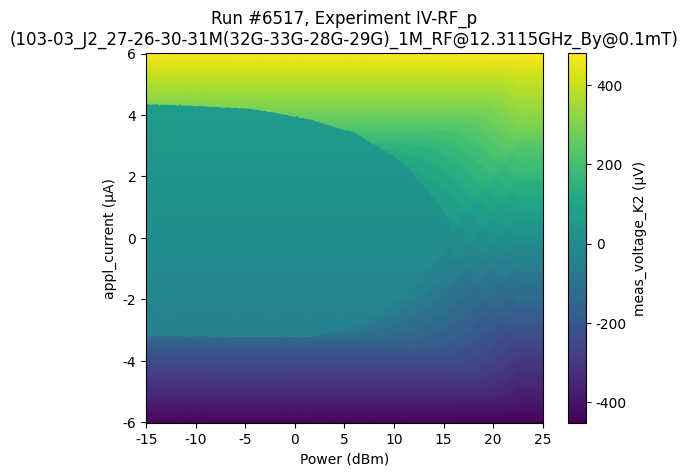

In [5]:
dataset = qc.load_by_id(6517)
axs, cbs = plot_dataset(dataset)

In [7]:
V = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
I = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
R = np.diff(V) / np.diff(I)
P = dataset.get_parameter_data()['meas_voltage_K2']['SGS_power']
# # B = dataset.get_parameter_data()['meas_voltage_K2']['x_field']
# V = pd.DataFrame(V, columns=['Voltage_K2'])
# I = pd.DataFrame(I, columns=['Current'])
# R = pd.DataFrame(R, columns=['Risistance'])
# P = pd.DataFrame(P, columns=['Power'])
# B = pd.DataFrame(B, columns=['B Field'])
# R_append = pd.concat([R, pd.DataFrame([None])], ignore_index=True).iloc[:, :-1]
# R_array = np.transpose(R_append.values.reshape(701,101))
print(len(V))
print(len(I))
print(len(R))
print(len(P))
# print(len(R_array))

321201
321201
321200
321201


In [8]:
# s = len(Vg)
s = len(I)
# print(s)
N = 1
for i in range(s - 1):
    if Power_dependence[i] != Power_dependence[i + 1]:
        break
    else:
        N = N + 1
        print('size of the gate array', N, end='\r')

NI = N
NB = s // N
# NVg = s // N
print('size of the field array', NB)
# print('size of the gate array', NVg)
print('size of the current', NI)

# 提取数据列
voltage_data = Vg[:N]  # 假设 Vg 是 Voltage 的数据列，如果不是，请替换为正确的列名
power_data = Power_dependence[:N]  # 假设 Power_dependence 是 Power 的数据列，如果不是，请替换为正确的列名

# 绘制 Voltage 对 Power 曲线
plt.plot(power_data, voltage_data, marker='o', linestyle='-')
plt.xlabel('Power (units)')
plt.ylabel('Voltage (units)')
plt.title('Voltage vs Power Dependence')

# 显示图表
plt.show()


NameError: name 'Power_dependence' is not defined